In [1]:
using DrWatson
@quickactivate "Doran_etal_2022"

In [2]:
using StatsPlots
using CSV, DataFrames
using KernelDensity
using Statistics

In [13]:
plotdf00 = CSV.read(joinpath(datadir(), "exp_pro", "MSAs", "MSAs-metrics-support=0-withphyml.csv"), DataFrame);
plotdf50 = CSV.read(joinpath(datadir(), "exp_pro", "MSAs", "MSAs-metrics-support=50-withphyml.csv"), DataFrame);
plotdf90 = CSV.read(joinpath(datadir(), "exp_pro", "MSAs", "MSAs-metrics-support=90-withphyml.csv"), DataFrame);
plotdf99 = CSV.read(joinpath(datadir(), "exp_pro", "MSAs", "MSAs-metrics-support=99-withphyml.csv"), DataFrame);

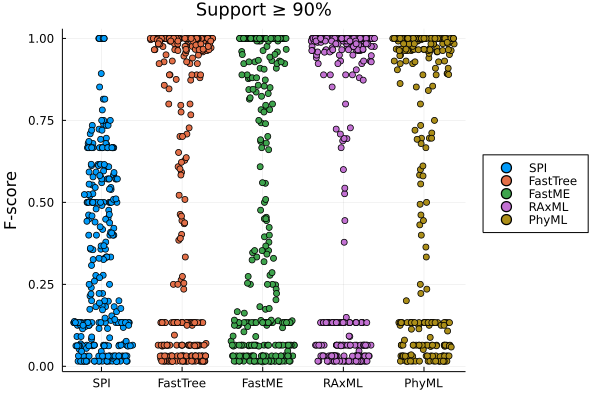

In [14]:
plot(legend=:outerright, 
    title = "Support ≥ 90%",
    titlefontsize=12,
    ylabel="F-score", 
    xticks=(1:5, [:SPI, :FastTree, :FastME, :RAxML, :PhyML]))
for lab in [:SPI_fscore, :FastTree_fscore, :FastME_fscore, :RAxML_fscore, :PhyML_fscore]
    tmpdf = plotdf90[.!ismissing.(plotdf90[!,lab]), :]
    dotplot!(tmpdf[!,lab], label=replace(string(lab), "_fscore"=>""))
end
plot!()

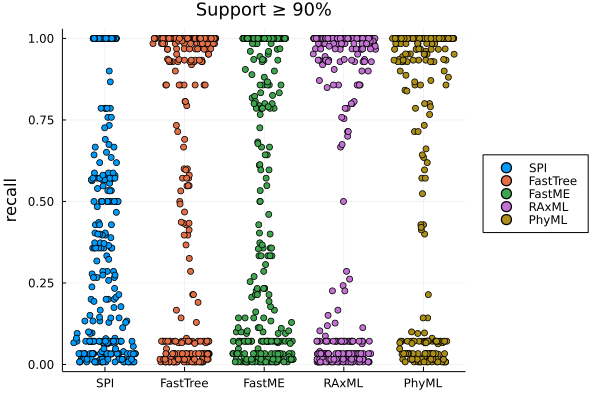

In [11]:
plot(legend=:outerright, 
    title = "Support ≥ 90%",
    titlefontsize=12,
    ylabel="recall", 
    xticks=(1:5, [:SPI, :FastTree, :FastME, :RAxML, :PhyML]))
for lab in [:SPI_recall :FastTree_recall :FastME_recall :RAxML_recall :PhyML_recall]
    tmpdf = plotdf90[.!ismissing.(plotdf90[!,lab]), :]
    dotplot!(tmpdf[!,lab], label=replace(string(lab), "_recall"=>""))
end
plot!()

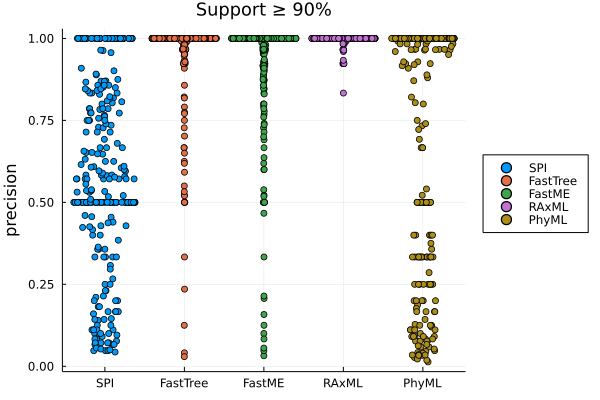

In [12]:
plot(legend=:outerright, 
    title = "Support ≥ 90%",
    titlefontsize=12,
    ylabel="precision", 
    xticks=(1:5, [:SPI, :FastTree, :FastME, :RAxML, :PhyML]))
for lab in [:SPI_precision :FastTree_precision :FastME_precision :RAxML_precision :PhyML_precision]
    tmpdf = plotdf90[.!ismissing.(plotdf90[!,lab]), :]
    dotplot!(tmpdf[!,lab], label=replace(string(lab), "_precision"=>""))
end
plot!()

In [15]:
nostarcaterpillar = plotdf90[(plotdf90.treetype .!= "startree") .& (plotdf90.treetype .!= "caterpillartree"), :];

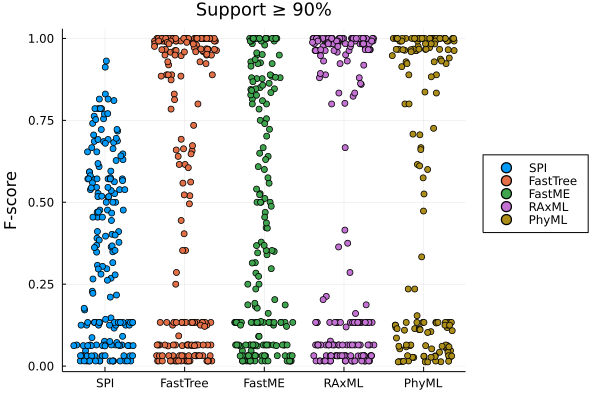

In [16]:
plot(legend=:outerright, 
    title = "Support ≥ 90%",
    titlefontsize=12,
    ylabel="F-score", 
    xticks=(1:5, [:SPI, :FastTree, :FastME, :RAxML, :PhyML]))
for lab in [:SPI_fscore, :FastTree_fscore, :FastME_fscore, :RAxML_fscore, :PhyML_fscore]
    tmpdf = nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,lab]), :]
    dotplot!(tmpdf[!,lab], label=replace(string(lab), "_fscore"=>""))
end
plot!()

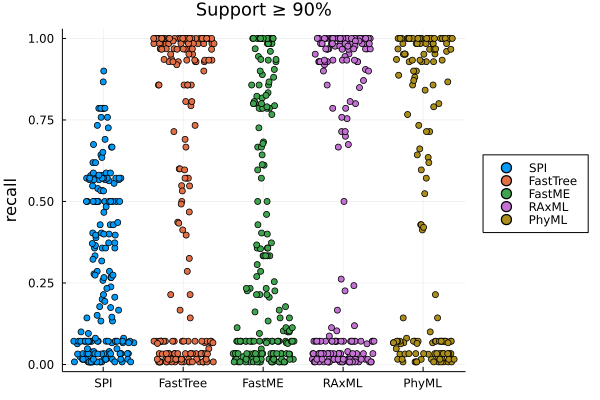

In [17]:
plot(legend=:outerright, 
    title = "Support ≥ 90%",
    titlefontsize=12,
    ylabel="recall", 
    xticks=(1:5, [:SPI, :FastTree, :FastME, :RAxML, :PhyML]))
for lab in [:SPI_recall :FastTree_recall :FastME_recall :RAxML_recall :PhyML_recall]
    tmpdf = nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,lab]), :]
    dotplot!(tmpdf[!,lab], label=replace(string(lab), "_recall"=>""))
end
plot!()

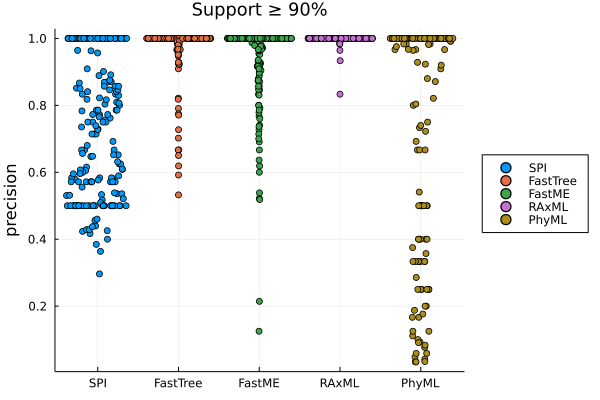

In [18]:
plot(legend=:outerright, 
    title = "Support ≥ 90%",
    titlefontsize=12,
    ylabel="precision", 
    xticks=(1:5, [:SPI, :FastTree, :FastME, :RAxML, :PhyML]))
for lab in [:SPI_precision :FastTree_precision :FastME_precision :RAxML_precision :PhyML_precision]
    tmpdf = nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,lab]), :]
    dotplot!(tmpdf[!,lab], label=replace(string(lab), "_precision"=>""))
end
plot!()

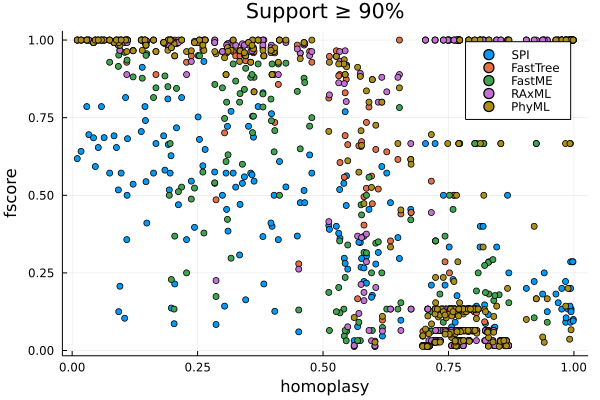

In [19]:
plot(title = "Support ≥ 90%", ylabel="fscore", xlabel="homoplasy")
@df plotdf90 scatter!(:homoplasy, :SPI_fscore, label="SPI")
@df plotdf90 scatter!(:homoplasy, :FastTree_fscore, label="FastTree")
@df plotdf90 scatter!(:homoplasy, :FastME_fscore, label="FastME")
@df plotdf90[.!ismissing.(plotdf90[!,:RAxML_fscore]), :] begin
    scatter!(:homoplasy, :RAxML_fscore, label="RAxML")
end
@df plotdf90[.!ismissing.(plotdf90[!,:PhyML_fscore]), :] begin
    scatter!(:homoplasy, :PhyML_fscore, label="PhyML")
end

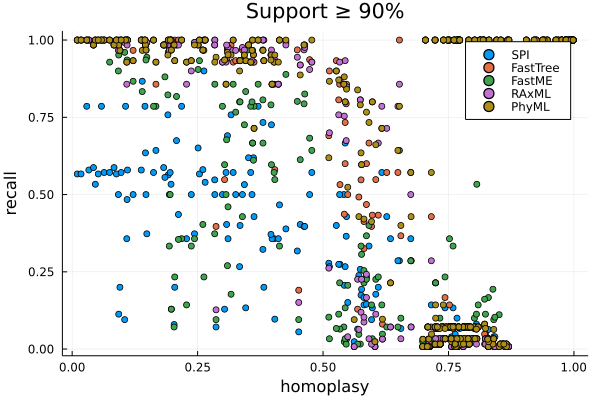

In [20]:
plot(title = "Support ≥ 90%", ylabel="recall", xlabel="homoplasy")
@df plotdf90 scatter!(:homoplasy, :SPI_recall, label="SPI")
@df plotdf90 scatter!(:homoplasy, :FastTree_recall, label="FastTree")
@df plotdf90 scatter!(:homoplasy, :FastME_recall, label="FastME")
@df plotdf90[.!ismissing.(plotdf90[!,:RAxML_recall]), :] begin
    scatter!(:homoplasy, :RAxML_recall, label="RAxML")
end
@df plotdf90[.!ismissing.(plotdf90[!,:PhyML_recall]), :] begin
    scatter!(:homoplasy, :PhyML_recall, label="PhyML")
end

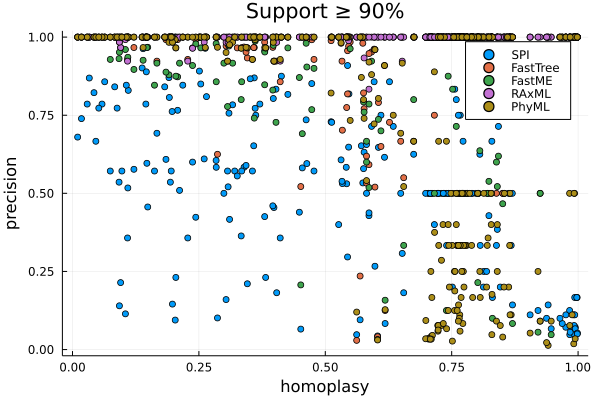

In [25]:
plot(title = "Support ≥ 90%", ylabel="precision", xlabel="homoplasy", lims=(-0.02, 1.02))
@df plotdf90 scatter!(:homoplasy, :SPI_precision, label="SPI")
@df plotdf90 scatter!(:homoplasy, :FastTree_precision, label="FastTree")
@df plotdf90 scatter!(:homoplasy, :FastME_precision, label="FastME")
@df plotdf90[.!ismissing.(plotdf90[!,:RAxML_precision]), :] begin
    scatter!(:homoplasy, :RAxML_precision, label="RAxML")
end
@df plotdf90[.!ismissing.(plotdf90[!,:PhyML_precision]), :] begin
    scatter!(:homoplasy, :PhyML_precision, label="PhyML")
end

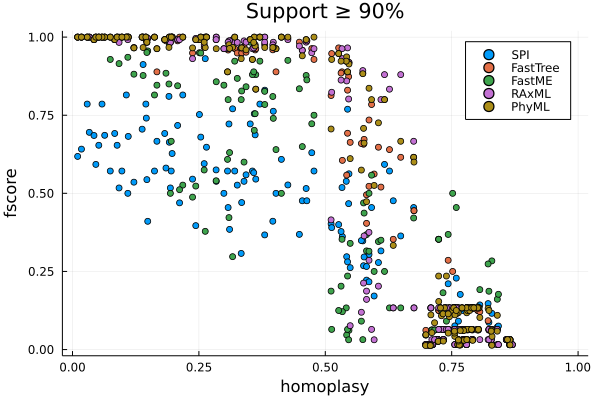

In [24]:
plot(title = "Support ≥ 90%", ylabel="fscore", xlabel="homoplasy", lims=(-0.02, 1.02))
@df nostarcaterpillar scatter!(:homoplasy, :SPI_fscore, label="SPI")
@df nostarcaterpillar scatter!(:homoplasy, :FastTree_fscore, label="FastTree")
@df nostarcaterpillar scatter!(:homoplasy, :FastME_fscore, label="FastME")
@df nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,:RAxML_fscore]), :] begin
    scatter!(:homoplasy, :RAxML_fscore, label="RAxML")
end
@df nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,:PhyML_fscore]), :] begin
    scatter!(:homoplasy, :PhyML_fscore, label="PhyML")
end

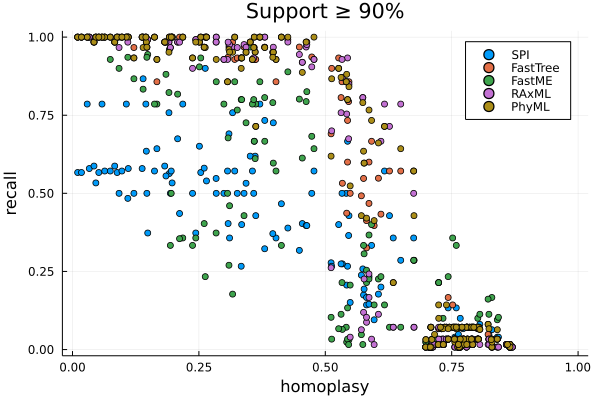

In [26]:
plot(title = "Support ≥ 90%", ylabel="recall", xlabel="homoplasy", lims=(-0.02, 1.02))
@df nostarcaterpillar scatter!(:homoplasy, :SPI_recall, label="SPI")
@df nostarcaterpillar scatter!(:homoplasy, :FastTree_recall, label="FastTree")
@df nostarcaterpillar scatter!(:homoplasy, :FastME_recall, label="FastME")
@df nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,:RAxML_recall]), :] begin
    scatter!(:homoplasy, :RAxML_recall, label="RAxML")
end
@df nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,:PhyML_recall]), :] begin
    scatter!(:homoplasy, :PhyML_recall, label="PhyML")
end

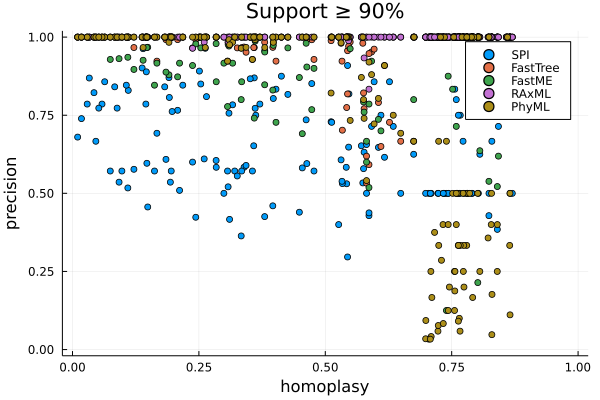

In [27]:
plot(title = "Support ≥ 90%", ylabel="precision", xlabel="homoplasy", lims=(-0.02, 1.02))
@df nostarcaterpillar scatter!(:homoplasy, :SPI_precision, label="SPI")
@df nostarcaterpillar scatter!(:homoplasy, :FastTree_precision, label="FastTree")
@df nostarcaterpillar scatter!(:homoplasy, :FastME_precision, label="FastME")
@df nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,:RAxML_precision]), :] begin
    scatter!(:homoplasy, :RAxML_precision, label="RAxML")
end
@df nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,:PhyML_precision]), :] begin
    scatter!(:homoplasy, :PhyML_precision, label="PhyML")
end

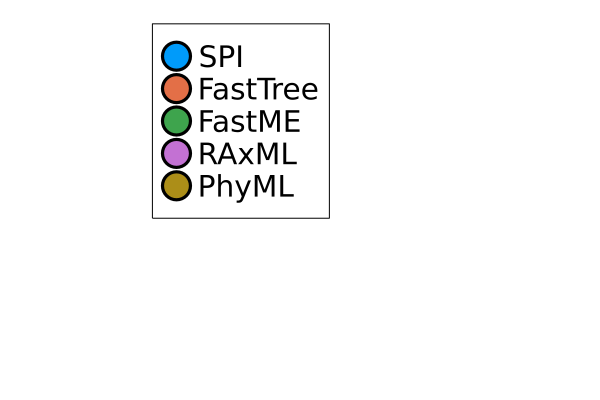

In [22]:
scatter([0 0 0 0 0], lims=(1,1), framestyle=:none, 
    label=["SPI" "FastTree" "FastME" "RAxML" "PhyML"], legend=:top,
    legendfontpointsize=20)

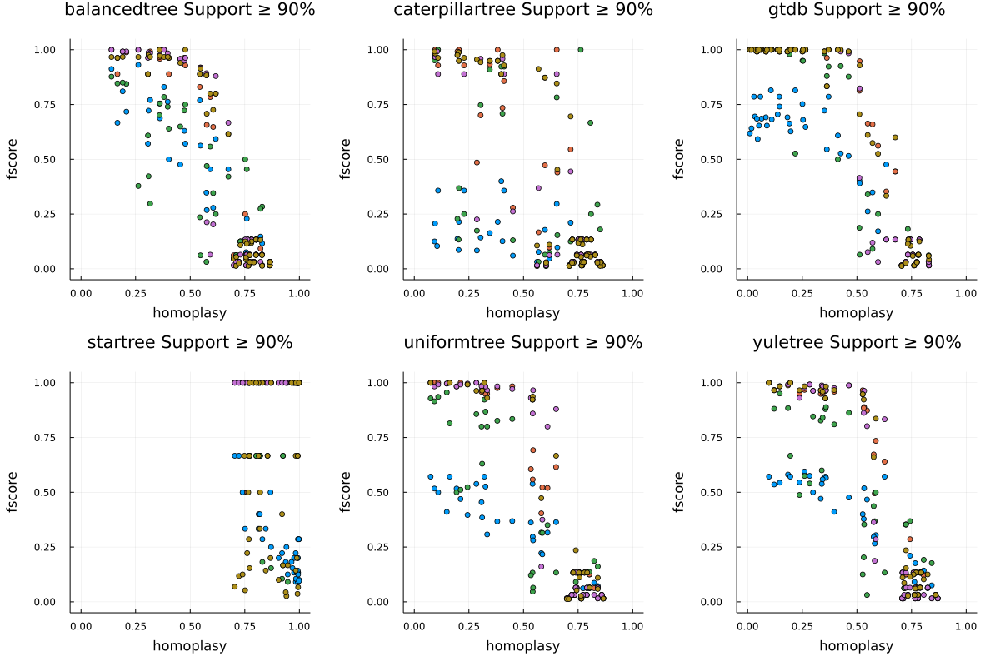

In [28]:
plot(layout=grid(2,3), size=(1200,800), lims=(-0.05, 1.05), margin=5Plots.Measures.mm, legend=:none)
for (i,tt) in enumerate(unique(plotdf90.treetype))
    tmpdf = plotdf90[plotdf90.treetype .== tt, :]
    plot!(sp=i,title = "$tt Support ≥ 90%", ylabel="fscore", xlabel="homoplasy")
    @df tmpdf scatter!(:homoplasy, :SPI_fscore,sp=i,markerstrokewidth=.5, label="SPI")
    @df tmpdf scatter!(:homoplasy, :FastTree_fscore,sp=i,markerstrokewidth=.5, label="FastTree")
    @df tmpdf scatter!(:homoplasy, :FastME_fscore,sp=i,markerstrokewidth=.5, label="FastME")
    @df tmpdf[.!ismissing.(tmpdf[!,:RAxML_fscore]), :] begin
        scatter!(:homoplasy, :RAxML_fscore,sp=i,markerstrokewidth=.5, label="RAxML")
    end
    @df tmpdf[.!ismissing.(tmpdf[!,:PhyML_fscore]), :] begin
        scatter!(:homoplasy, :PhyML_fscore,sp=i,markerstrokewidth=.5, label="PhyML")
    end
end
plot!()

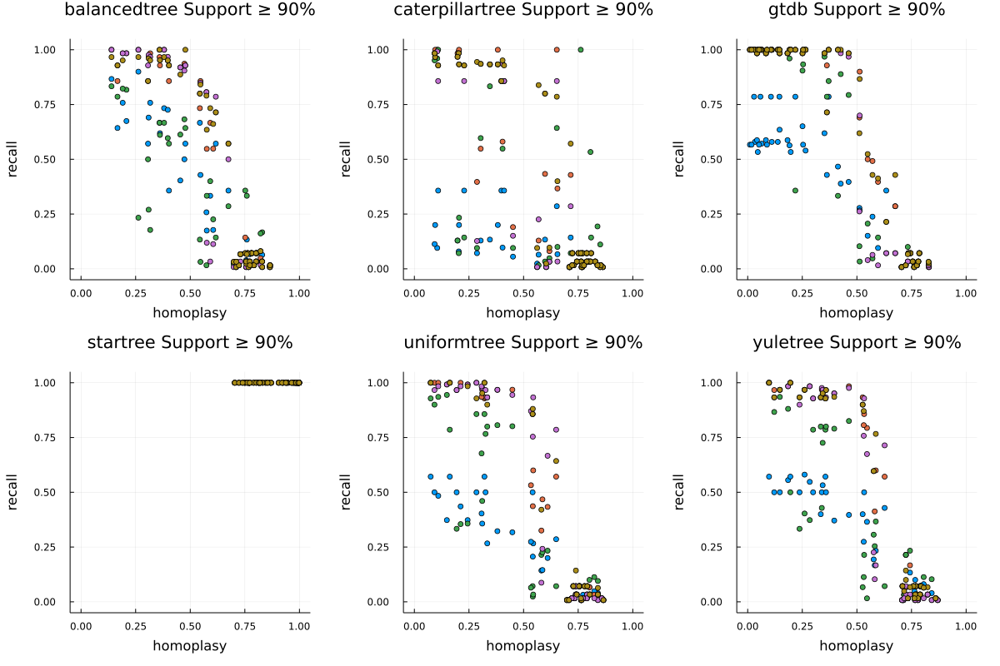

In [29]:
plot(layout=grid(2,3), size=(1200,800), lims=(-0.05, 1.05), margin=5Plots.Measures.mm, legend=:none)
for (i,tt) in enumerate(unique(plotdf90.treetype))
    tmpdf = plotdf90[plotdf90.treetype .== tt, :]
    plot!(sp=i,title = "$tt Support ≥ 90%", ylabel="recall", xlabel="homoplasy")
    @df tmpdf scatter!(:homoplasy, :SPI_recall,sp=i,markerstrokewidth=.5, label="SPI")
    @df tmpdf scatter!(:homoplasy, :FastTree_recall,sp=i,markerstrokewidth=.5, label="FastTree")
    @df tmpdf scatter!(:homoplasy, :FastME_recall,sp=i,markerstrokewidth=.5, label="FastME")
    @df tmpdf[.!ismissing.(tmpdf[!,:RAxML_recall]), :] begin
        scatter!(:homoplasy, :RAxML_recall,sp=i,markerstrokewidth=.5, label="RAxML")
    end   
    @df tmpdf[.!ismissing.(tmpdf[!,:PhyML_recall]), :] begin
        scatter!(:homoplasy, :PhyML_recall,sp=i,markerstrokewidth=.5, label="PhyML")
    end
end
plot!()

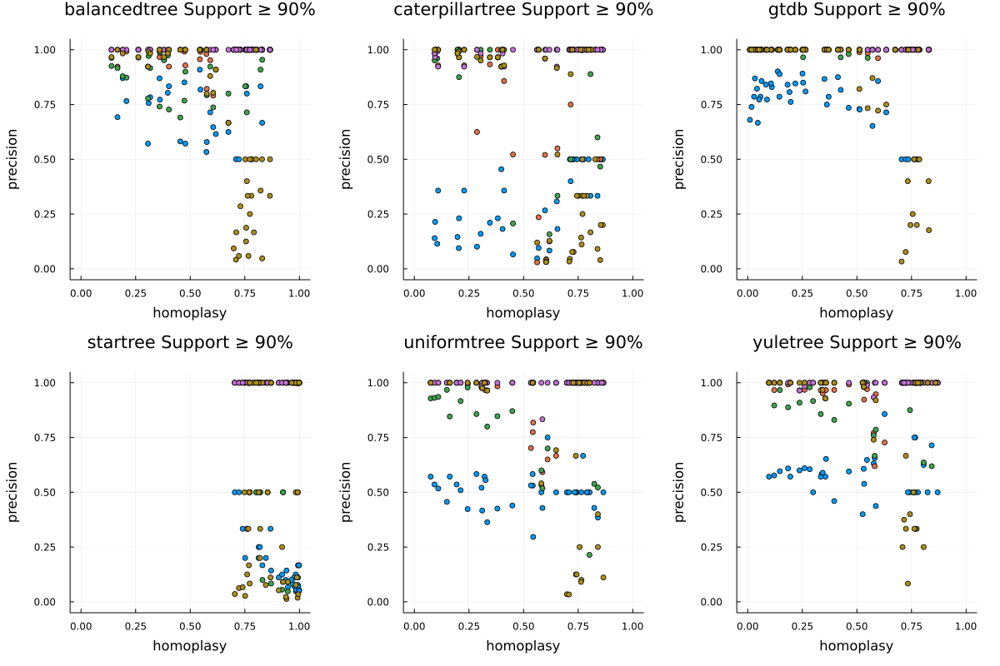

In [30]:
plot(layout=grid(2,3), size=(1200,800), lims=(-0.05, 1.05), margin=5Plots.Measures.mm, legend=:none)
for (i,tt) in enumerate(unique(plotdf90.treetype))
    tmpdf = plotdf90[plotdf90.treetype .== tt, :]
    plot!(sp=i,title = "$tt Support ≥ 90%", ylabel="precision", xlabel="homoplasy")
    @df tmpdf scatter!(:homoplasy, :SPI_precision,sp=i,markerstrokewidth=.5, label="SPI")
    @df tmpdf scatter!(:homoplasy, :FastTree_precision,sp=i,markerstrokewidth=.5, label="FastTree")
    @df tmpdf scatter!(:homoplasy, :FastME_precision,sp=i,markerstrokewidth=.5, label="FastME")
    @df tmpdf[.!ismissing.(tmpdf[!,:RAxML_precision]), :] begin
        scatter!(:homoplasy, :RAxML_precision,sp=i,markerstrokewidth=.5, label="RAxML")
    end   
    @df tmpdf[.!ismissing.(tmpdf[!,:PhyML_precision]), :] begin
        scatter!(:homoplasy, :PhyML_precision,sp=i,markerstrokewidth=.5, label="PhyML")
    end
end
plot!()

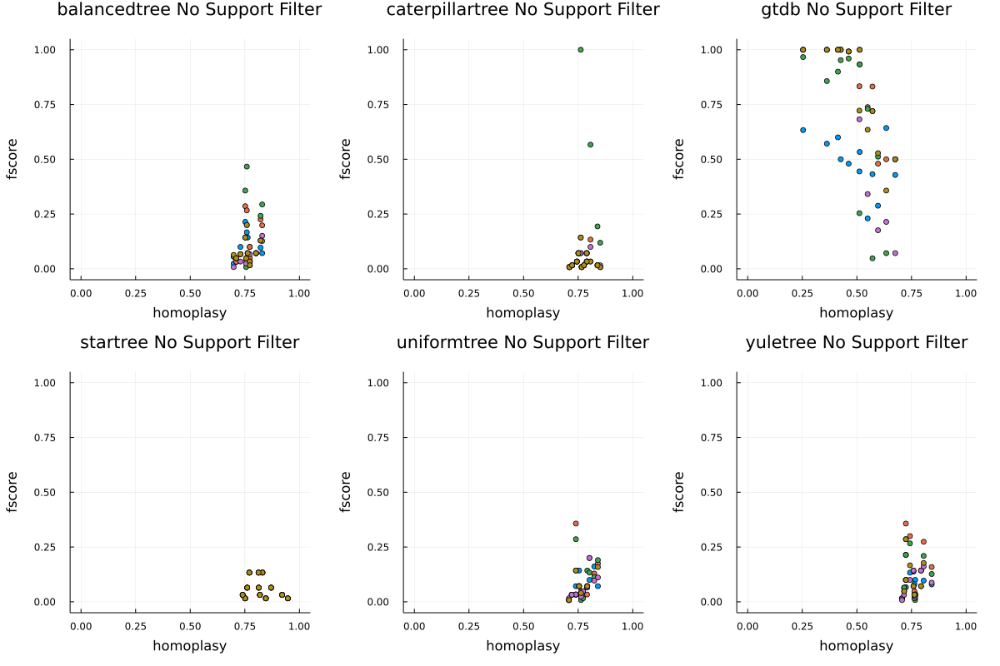

In [32]:
plot(layout=grid(2,3), size=(1200,800), lims=(-0.05, 1.05), margin=5Plots.Measures.mm, legend=:none)
tmpdf1000 = plotdf00[plotdf00.nfeatures .== 1000, :]
for (i,tt) in enumerate(unique(plotdf00.treetype))
    tmpdf = tmpdf1000[tmpdf1000.treetype .== tt, :]
    plot!(sp=i,title = "$tt No Support Filter", ylabel="fscore", xlabel="homoplasy")
    @df tmpdf scatter!(:homoplasy, :SPI_fscore,sp=i,markerstrokewidth=.5, label="SPI")
    @df tmpdf scatter!(:homoplasy, :FastTree_fscore,sp=i,markerstrokewidth=.5, label="FastTree")
    @df tmpdf scatter!(:homoplasy, :FastME_fscore,sp=i,markerstrokewidth=.5, label="FastME")
    @df tmpdf[.!ismissing.(tmpdf[!,:RAxML_fscore]), :] begin
        scatter!(:homoplasy, :RAxML_fscore,sp=i,markerstrokewidth=.5, label="RAxML")
    end
    @df tmpdf[.!ismissing.(tmpdf[!,:PhyML_fscore]), :] begin
        scatter!(:homoplasy, :PhyML_fscore,sp=i,markerstrokewidth=.5, label="PhyML")
    end
end
plot!()

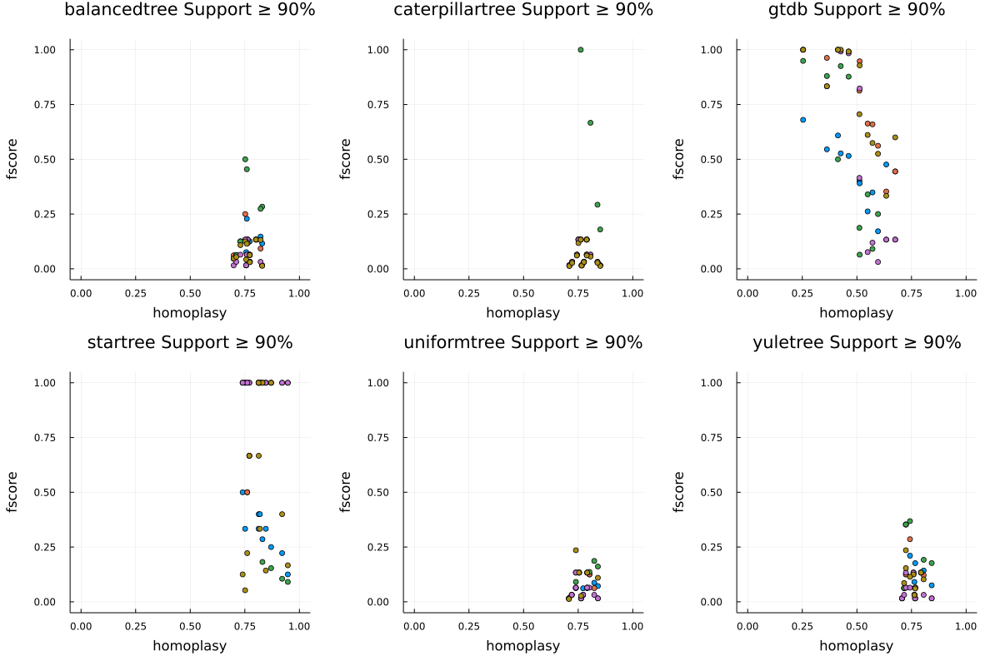

In [34]:
plot(layout=grid(2,3), size=(1200,800), lims=(-0.05, 1.05), margin=5Plots.Measures.mm, legend=:none)
tmpdf1000 = plotdf90[plotdf90.nfeatures .== 1000, :]
for (i,tt) in enumerate(unique(plotdf90.treetype))
    tmpdf = tmpdf1000[tmpdf1000.treetype .== tt, :]
    plot!(sp=i,title = "$tt Support ≥ 90%", ylabel="fscore", xlabel="homoplasy")
    @df tmpdf scatter!(:homoplasy, :SPI_fscore,sp=i,markerstrokewidth=.5, label="SPI")
    @df tmpdf scatter!(:homoplasy, :FastTree_fscore,sp=i,markerstrokewidth=.5, label="FastTree")
    @df tmpdf scatter!(:homoplasy, :FastME_fscore,sp=i,markerstrokewidth=.5, label="FastME")
    @df tmpdf[.!ismissing.(tmpdf[!,:RAxML_fscore]), :] begin
        scatter!(:homoplasy, :RAxML_fscore,sp=i,markerstrokewidth=.5, label="RAxML")
    end
    @df tmpdf[.!ismissing.(tmpdf[!,:PhyML_fscore]), :] begin
        scatter!(:homoplasy, :PhyML_fscore,sp=i,markerstrokewidth=.5, label="PhyML")
    end
end
plot!()

## Fscore x Branch depth

In [35]:
nostarcaterpillar = plotdf90[(plotdf90.treetype .!= "startree") .& (plotdf90.treetype .!= "caterpillartree"), :];

In [36]:
plotlyjs()

Plots.PlotlyJSBackend()

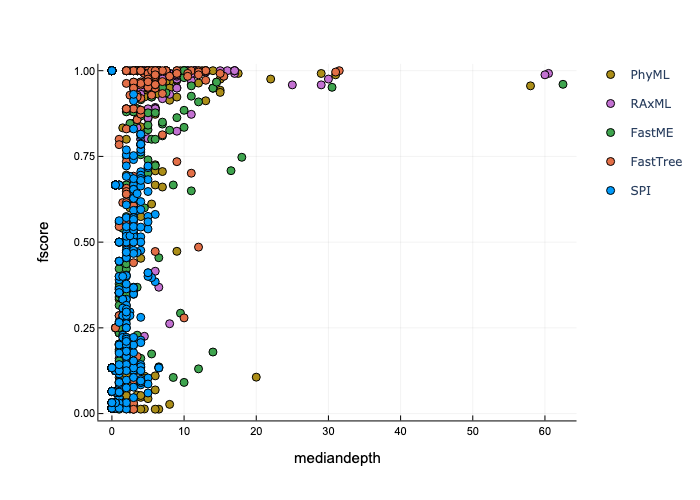

In [39]:
plot(ylabel="fscore", ylims=(-0.02,1.02), xlabel="mediandepth")
@df plotdf90 scatter!(:PhyML_mediandepth, :PhyML_fscore, hover=:msaname, c=5, label="PhyML")
@df plotdf90 scatter!(:RAxML_mediandepth, :RAxML_fscore,hover=:msaname, c=4, label="RAxML")
@df plotdf90 scatter!(:FastME_mediandepth, :FastME_fscore,hover=:msaname, c=3, label="FastME")
@df plotdf90 scatter!(:FastTree_mediandepth, :FastTree_fscore,hover=:msaname, c=2, label="FastTree")
@df plotdf90 scatter!(:SPI_mediandepth, :SPI_fscore,hover=:msaname, c=1, label="SPI")

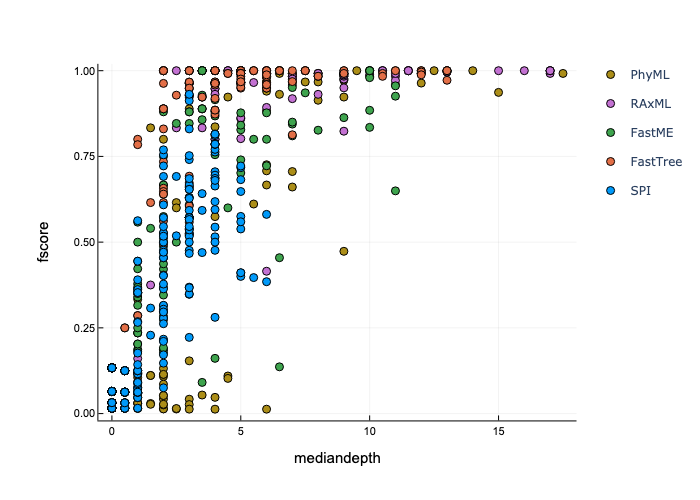

In [38]:
plot(ylabel="fscore", ylims=(-0.02,1.02), xlabel="mediandepth")
@df nostarcaterpillar scatter!(:PhyML_mediandepth, :PhyML_fscore, hover=:msaname, c=5, label="PhyML")
@df nostarcaterpillar scatter!(:RAxML_mediandepth, :RAxML_fscore,hover=:msaname, c=4, label="RAxML")
@df nostarcaterpillar scatter!(:FastME_mediandepth, :FastME_fscore,hover=:msaname, c=3, label="FastME")
@df nostarcaterpillar scatter!(:FastTree_mediandepth, :FastTree_fscore,hover=:msaname, c=2, label="FastTree")
@df nostarcaterpillar scatter!(:SPI_mediandepth, :SPI_fscore,hover=:msaname, c=1, label="SPI")

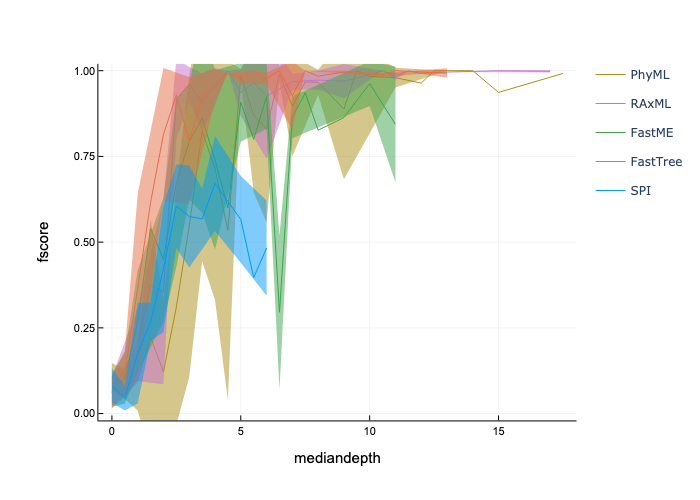

In [40]:
plot(ylabel="fscore", ylims=(-0.02,1.02), xlabel="mediandepth")
ribbondf = nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,:PhyML_fscore]), :] |>
    df->groupby(df, :PhyML_mediandepth) |>
    df->combine(df, :PhyML_fscore => mean, :PhyML_fscore => std) |>
    df->sort(df, [:PhyML_mediandepth])
@df ribbondf plot!(:PhyML_mediandepth, :PhyML_fscore_mean, ribbon=:PhyML_fscore_std, c=5, label="PhyML")
ribbondf = nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,:RAxML_fscore]), :] |>
    df->groupby(df, :RAxML_mediandepth) |>
    df->combine(df, :RAxML_fscore => mean, :RAxML_fscore => std) |>
    df->sort(df, [:RAxML_mediandepth])
@df ribbondf plot!(:RAxML_mediandepth, :RAxML_fscore_mean, ribbon=:RAxML_fscore_std, c=4, label="RAxML")
ribbondf = nostarcaterpillar |>
    df->groupby(df, :FastME_mediandepth) |>
    df->combine(df, :FastME_fscore => mean, :FastME_fscore => std) |>
    df->sort(df, [:FastME_mediandepth])
@df ribbondf plot!(:FastME_mediandepth, :FastME_fscore_mean, ribbon=:FastME_fscore_std, c=3, label="FastME")
ribbondf = nostarcaterpillar |>
    df->groupby(df, :FastTree_mediandepth) |>
    df->combine(df, :FastTree_fscore => mean, :FastTree_fscore => std) |>
    df->sort(df, [:FastTree_mediandepth])
    @df ribbondf plot!(:FastTree_mediandepth, :FastTree_fscore_mean, ribbon=:FastTree_fscore_std, c=2, label="FastTree")
ribbondf = nostarcaterpillar |>
    df->groupby(df, :SPI_mediandepth) |>
    df->combine(df, :SPI_fscore => mean, :SPI_fscore => std) |>
    df->sort(df, [:SPI_mediandepth])
@df ribbondf plot!(:SPI_mediandepth, :SPI_fscore_mean, ribbon=:SPI_fscore_std, c=1, label="SPI")

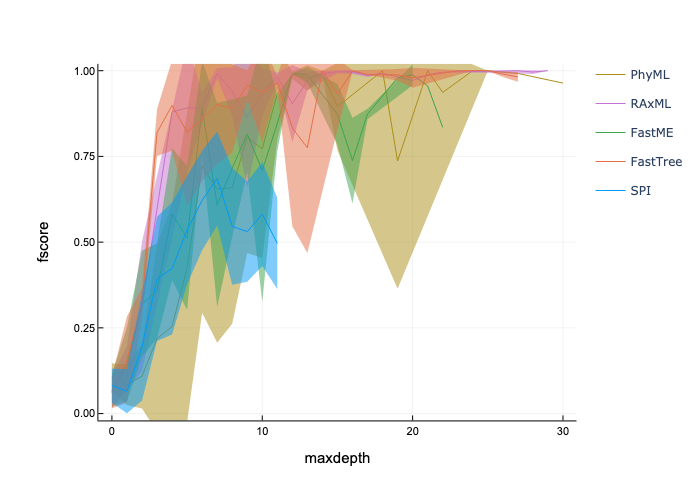

In [41]:
plot(ylabel="fscore", ylims=(-0.02,1.02), xlabel="maxdepth")
ribbondf = nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,:PhyML_fscore]), :] |>
    df->groupby(df, :PhyML_maxdepth) |>
    df->combine(df, :PhyML_fscore => mean, :PhyML_fscore => std) |>
    df->sort(df, [:PhyML_maxdepth])
@df ribbondf plot!(:PhyML_maxdepth, :PhyML_fscore_mean, ribbon=:PhyML_fscore_std, c=5, label="PhyML")
ribbondf = nostarcaterpillar[.!ismissing.(nostarcaterpillar[!,:RAxML_fscore]), :] |>
    df->groupby(df, :RAxML_maxdepth) |>
    df->combine(df, :RAxML_fscore => mean, :RAxML_fscore => std) |>
    df->sort(df, [:RAxML_maxdepth])
@df ribbondf plot!(:RAxML_maxdepth, :RAxML_fscore_mean, ribbon=:RAxML_fscore_std, c=4, label="RAxML")
ribbondf = nostarcaterpillar |>
    df->groupby(df, :FastME_maxdepth) |>
    df->combine(df, :FastME_fscore => mean, :FastME_fscore => std) |>
    df->sort(df, [:FastME_maxdepth])
@df ribbondf plot!(:FastME_maxdepth, :FastME_fscore_mean, ribbon=:FastME_fscore_std, c=3, label="FastME")
ribbondf = nostarcaterpillar |>
    df->groupby(df, :FastTree_maxdepth) |>
    df->combine(df, :FastTree_fscore => mean, :FastTree_fscore => std) |>
    df->sort(df, [:FastTree_maxdepth])
    @df ribbondf plot!(:FastTree_maxdepth, :FastTree_fscore_mean, ribbon=:FastTree_fscore_std, c=2, label="FastTree")
ribbondf = nostarcaterpillar |>
    df->groupby(df, :SPI_maxdepth) |>
    df->combine(df, :SPI_fscore => mean, :SPI_fscore => std) |>
    df->sort(df, [:SPI_maxdepth])
@df ribbondf plot!(:SPI_maxdepth, :SPI_fscore_mean, ribbon=:SPI_fscore_std, c=1, label="SPI")

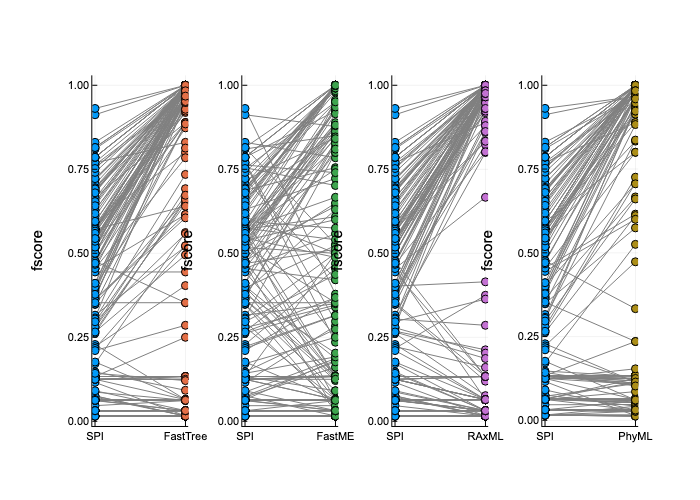

In [42]:
plot(size=(250,600), ylabel="fscore", 
    xticks=(1:2, ["SPI", "PhyML"]),
    margin=5Plots.Measures.mm,)
plot!(Matrix(nostarcaterpillar[!, [:SPI_fscore, :PhyML_fscore]])', c=:grey, label="")
@df nostarcaterpillar scatter!(repeat([1.], length(:SPI_fscore)), :SPI_fscore, c=1, label="")
pphyml = @df nostarcaterpillar scatter!(repeat([2.], length(:PhyML_fscore)), :PhyML_fscore, c=5, label="")

plot(size=(250,600), ylabel="fscore", 
    xticks=(1:2, ["SPI", "RAxML"]),
    margin=5Plots.Measures.mm,)
plot!(Matrix(nostarcaterpillar[!, [:SPI_fscore, :RAxML_fscore]])', c=:grey, label="")
@df nostarcaterpillar scatter!(repeat([1.], length(:SPI_fscore)), :SPI_fscore, c=1, label="")
praxml = @df nostarcaterpillar scatter!(repeat([2.], length(:RAxML_fscore)), :RAxML_fscore, c=4, label="")

plot(size=(250,600), ylabel="fscore", 
    xticks=(1:2, ["SPI", "FastME"]),
    margin=5Plots.Measures.mm,)
plot!(Matrix(nostarcaterpillar[!, [:SPI_fscore, :FastME_fscore]])', c=:grey, label="")
@df nostarcaterpillar scatter!(repeat([1.], length(:SPI_fscore)), :SPI_fscore, c=1, label="")
pfastme = @df nostarcaterpillar scatter!(repeat([2.], length(:FastME_fscore)), :FastME_fscore, c=3, label="")

plot(size=(250,600), ylabel="fscore", 
    xticks=(1:2, ["SPI", "FastTree"]),
    margin=5Plots.Measures.mm,)
plot!(Matrix(nostarcaterpillar[!, [:SPI_fscore, :FastTree_fscore]])', c=:grey, label="")
@df nostarcaterpillar scatter!(repeat([1.], length(:SPI_fscore)), :SPI_fscore, c=1, label="")
pfasttree = @df nostarcaterpillar scatter!(repeat([2.], length(:FastTree_fscore)), :FastTree_fscore, c=2, label="")

plot(pfasttree, pfastme, praxml, pphyml, layout=grid(1,4), size=(1000,500))

In [43]:
diffplotdf = nostarcaterpillar |>
    df->transform(df,
        [:SPI_fscore, :FastTree_fscore] => ((x,y)->x.-y) => :SPI_FastTree_fscore_diff,
        [:SPI_fscore, :FastME_fscore] => ((x,y)->x.-y) => :SPI_FastME_fscore_diff,
        [:SPI_fscore, :RAxML_fscore] => ((x,y)->x.-y) => :SPI_RAxML_fscore_diff,
        [:SPI_fscore, :PhyML_fscore] => ((x,y)->x.-y) => :SPI_PhyML_fscore_diff,
        );

In [44]:
using HypothesisTests

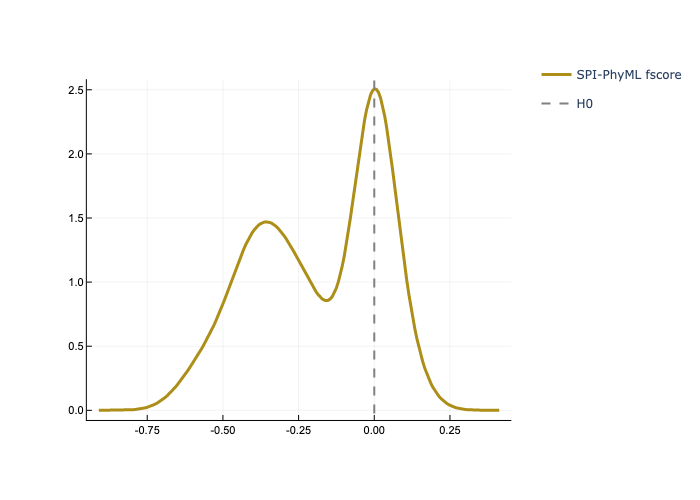

In [67]:
plot(;margin=5Plots.Measures.mm,)
density!(filter(!ismissing, diffplotdf.SPI_PhyML_fscore_diff), norm=true, lw=3, c=5, label="SPI-PhyML fscore")
# density!(filter(!ismissing, diffplotdf.SPI_PhyML_fscore_diff[diffplotdf.homoplasy .> 0.69]), norm=true, lw=3, c=1, label="High Homoplasy")
vline!([0.], linestyle=:dash, c=:grey, lw=2, label="H0")

In [46]:
SignedRankTest(Float64.(filter(!ismissing, diffplotdf.SPI_PhyML_fscore_diff)))

Approximate Wilcoxon signed rank test
-------------------------------------
Population details:
    parameter of interest:   Location parameter (pseudomedian)
    value under h_0:         0
    point estimate:          -0.158854
    95% confidence interval: (-0.2114, -0.1502)

Test summary:
    outcome with 95% confidence: reject h_0
    two-sided p-value:           <1e-13

Details:
    number of observations:      152
    Wilcoxon rank-sum statistic: 1147.5
    rank sums:                   [1147.5, 8305.5]
    adjustment for ties:         402.0
    normal approximation (μ, σ): (-3579.0, 465.428)


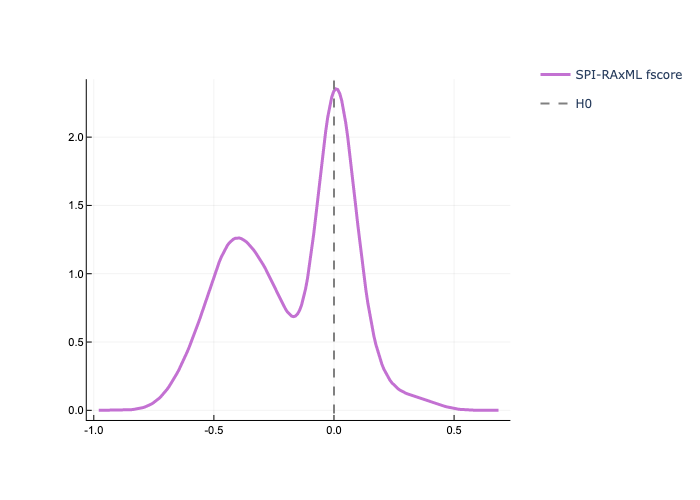

In [47]:
plot(;margin=5Plots.Measures.mm,)
density!(filter(!ismissing, diffplotdf.SPI_RAxML_fscore_diff), lw=3, c=4, label="SPI-RAxML fscore")
vline!([0.], linestyle=:dash, c=:grey, lw=2, label="H0")

In [48]:
SignedRankTest(diffplotdf.SPI_RAxML_fscore_diff)

Approximate Wilcoxon signed rank test
-------------------------------------
Population details:
    parameter of interest:   Location parameter (pseudomedian)
    value under h_0:         0
    point estimate:          -0.0400678
    95% confidence interval: (-0.204, -0.1415)

Test summary:
    outcome with 95% confidence: reject h_0
    two-sided p-value:           <1e-14

Details:
    number of observations:      192
    Wilcoxon rank-sum statistic: 1547.0
    rank sums:                   [1547.0, 10388.0]
    adjustment for ties:         1608.0
    normal approximation (μ, σ): (-4420.5, 554.34)


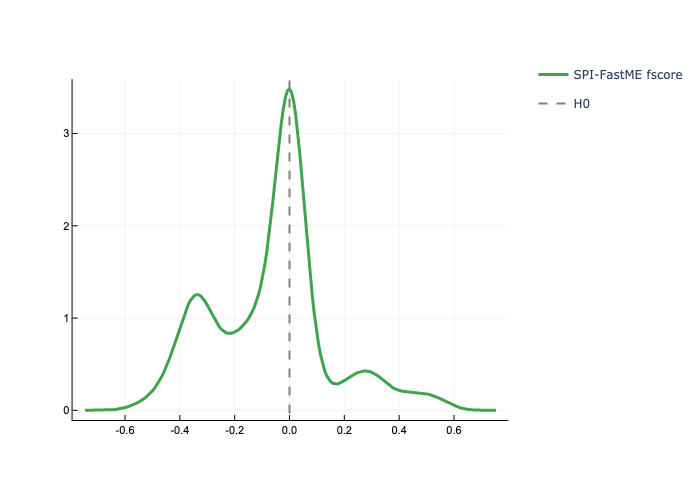

In [49]:
plot(;margin=5Plots.Measures.mm,)
density!(filter(!ismissing, diffplotdf.SPI_FastME_fscore_diff), lw=3, c=3, label="SPI-FastME fscore")
vline!([0.], linestyle=:dash, c=:grey, lw=2, label="H0")

In [50]:
SignedRankTest(diffplotdf.SPI_FastME_fscore_diff)

Approximate Wilcoxon signed rank test
-------------------------------------
Population details:
    parameter of interest:   Location parameter (pseudomedian)
    value under h_0:         0
    point estimate:          -0.00125608
    95% confidence interval: (-0.09803, -0.02393)

Test summary:
    outcome with 95% confidence: reject h_0
    two-sided p-value:           <1e-05

Details:
    number of observations:      192
    Wilcoxon rank-sum statistic: 3325.0
    rank sums:                   [3325.0, 8456.0]
    adjustment for ties:         1350.0
    normal approximation (μ, σ): (-2565.5, 548.971)


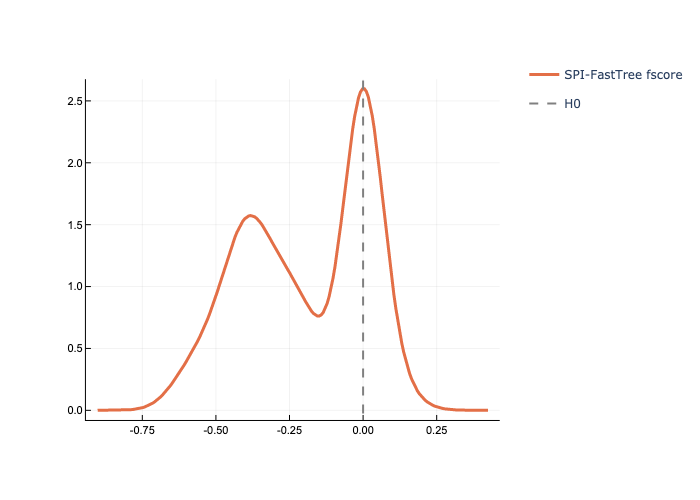

In [51]:
plot(;margin=5Plots.Measures.mm,)
density!(filter(!ismissing, diffplotdf.SPI_FastTree_fscore_diff), lw=3, c=2, label="SPI-FastTree fscore")
vline!([0.], linestyle=:dash, c=:grey, lw=2, label="H0")

In [52]:
SignedRankTest(diffplotdf.SPI_FastTree_fscore_diff)

Approximate Wilcoxon signed rank test
-------------------------------------
Population details:
    parameter of interest:   Location parameter (pseudomedian)
    value under h_0:         0
    point estimate:          -0.194698
    95% confidence interval: (-0.2143, -0.1666)

Test summary:
    outcome with 95% confidence: reject h_0
    two-sided p-value:           <1e-21

Details:
    number of observations:      192
    Wilcoxon rank-sum statistic: 492.0
    rank sums:                   [492.0, 10534.0]
    adjustment for ties:         1434.0
    normal approximation (μ, σ): (-5021.0, 522.363)


In [ ]:
xs = hcat(nostarcaterpillar.homoplasy, nostarcaterpillar.homoplasy)';

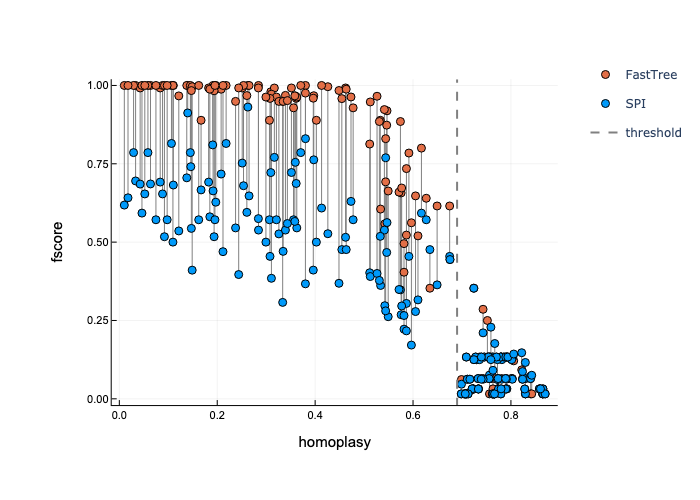

In [53]:
plot(ylabel="fscore", ylims=(-0.02,1.02), xlabel="homoplasy", margin=5Plots.Measures.mm)
# xs = Matrix(nostarcaterpillar[:, [:homoplasy, :homoplasy]])'
xs = hcat(nostarcaterpillar.homoplasy, nostarcaterpillar.homoplasy)';
ys = Matrix(nostarcaterpillar[:, [:SPI_fscore, :FastTree_fscore]])'
plot!(xs, ys, c=:grey, label="")
@df nostarcaterpillar scatter!(:homoplasy, :FastTree_fscore, hover=:msaname, c=2, label="FastTree")
@df nostarcaterpillar scatter!(:homoplasy, :SPI_fscore,hover=:msaname, c=1, label="SPI")
vline!([.69], c=:grey, ls=:dash, lw=2, label="threshold")

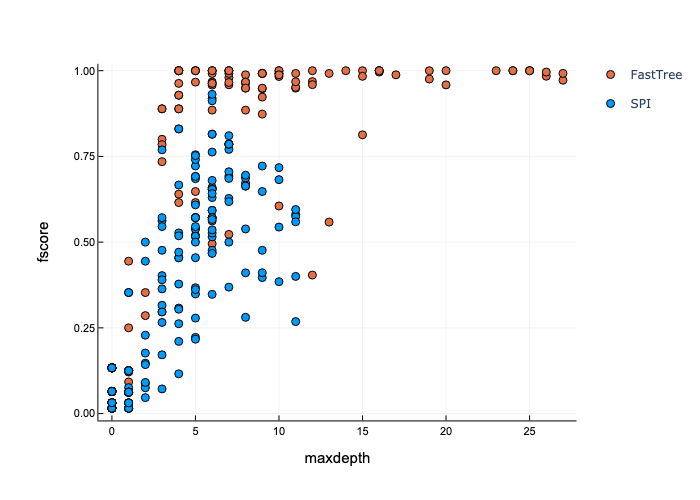

In [54]:
plot(ylabel="fscore", ylims=(-0.02,1.02), xlabel="maxdepth")
# @df nostarcaterpillar scatter!(:PhyML_maxdepth, :PhyML_fscore, hover=:msaname, c=5, label="PhyML")
# @df nostarcaterpillar scatter!(:RAxML_maxdepth, :RAxML_fscore,hover=:msaname, c=4, label="RAxML")
# @df nostarcaterpillar scatter!(:FastME_maxdepth, :FastME_fscore,hover=:msaname, c=3, label="FastME")
p1 = nostarcaterpillar[:, [:SPI_maxdepth, :SPI_fscore]]
p2 = nostarcaterpillar[:, [:SPI_maxdepth, :SPI_fscore]]
@df nostarcaterpillar scatter!(:FastTree_maxdepth, :FastTree_fscore,hover=:msaname, c=2, label="FastTree")
@df nostarcaterpillar scatter!(:SPI_maxdepth, :SPI_fscore,hover=:msaname, c=1, label="SPI")

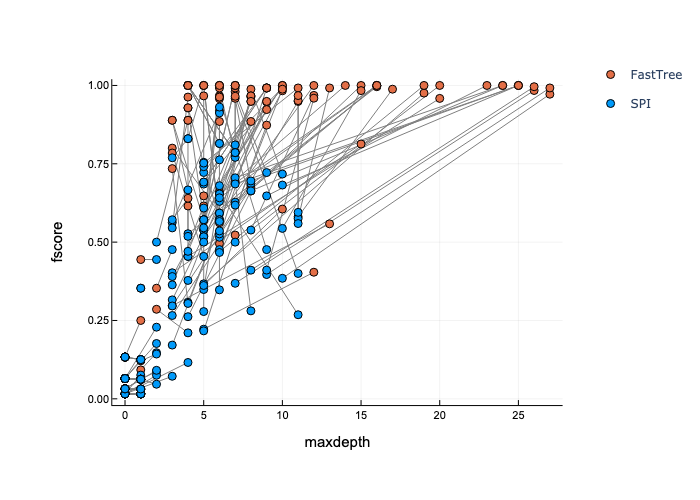

In [55]:
plot(ylabel="fscore", ylims=(-0.02,1.02), xlabel="maxdepth", margin=5Plots.Measures.mm)
xs = Matrix(nostarcaterpillar[:, [:SPI_maxdepth, :FastTree_maxdepth]])'
ys = Matrix(nostarcaterpillar[:, [:SPI_fscore, :FastTree_fscore]])'
plot!(xs, ys, c=:grey, label="")
@df nostarcaterpillar scatter!(:FastTree_maxdepth, :FastTree_fscore, hover=:msaname, c=2, label="FastTree")
@df nostarcaterpillar scatter!(:SPI_maxdepth, :SPI_fscore,hover=:msaname, c=1, label="SPI")

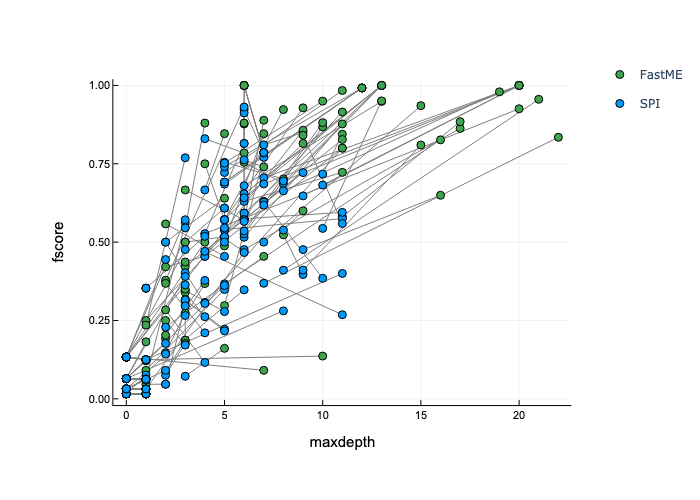

In [56]:
plot(ylabel="fscore", ylims=(-0.02,1.02), xlabel="maxdepth", margin=5Plots.Measures.mm)
xs = Matrix(nostarcaterpillar[:, [:SPI_maxdepth, :FastME_maxdepth]])'
ys = Matrix(nostarcaterpillar[:, [:SPI_fscore, :FastME_fscore]])'
plot!(xs, ys, c=:grey, label="")
@df nostarcaterpillar scatter!(:FastME_maxdepth, :FastME_fscore, hover=:msaname, c=3, label="FastME")
@df nostarcaterpillar scatter!(:SPI_maxdepth, :SPI_fscore,hover=:msaname, c=1, label="SPI")

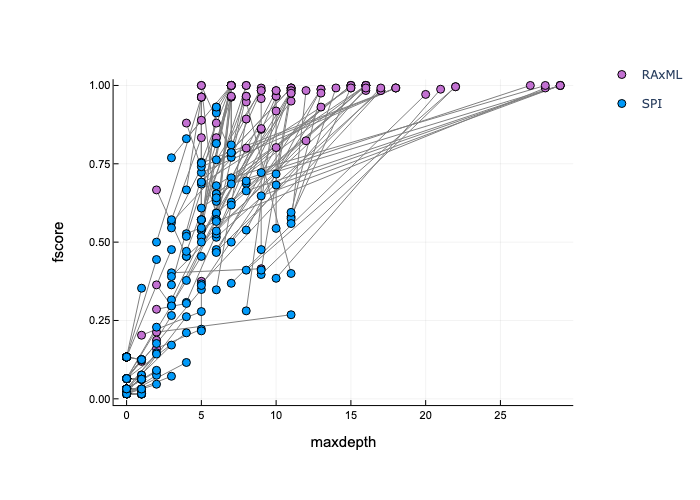

In [57]:
plot(ylabel="fscore", ylims=(-0.02,1.02), xlabel="maxdepth", margin=5Plots.Measures.mm)
xs = Matrix(nostarcaterpillar[:, [:SPI_maxdepth, :RAxML_maxdepth]])'
ys = Matrix(nostarcaterpillar[:, [:SPI_fscore, :RAxML_fscore]])'
plot!(xs, ys, c=:grey, label="")
@df nostarcaterpillar scatter!(:RAxML_maxdepth, :RAxML_fscore, hover=:msaname, c=4, label="RAxML")
@df nostarcaterpillar scatter!(:SPI_maxdepth, :SPI_fscore,hover=:msaname, c=1, label="SPI")

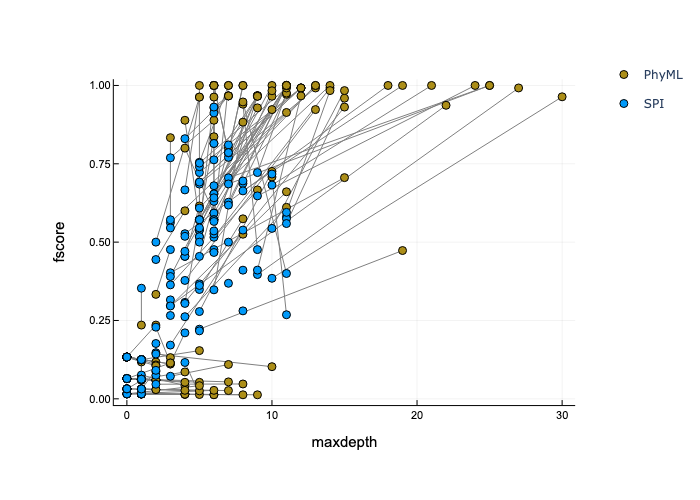

In [58]:
plot(ylabel="fscore", ylims=(-0.02,1.02), xlabel="maxdepth", margin=5Plots.Measures.mm)
xs = Matrix(nostarcaterpillar[:, [:SPI_maxdepth, :PhyML_maxdepth]])'
ys = Matrix(nostarcaterpillar[:, [:SPI_fscore, :PhyML_fscore]])'
plot!(xs, ys, c=:grey, label="")
@df nostarcaterpillar scatter!(:PhyML_maxdepth, :PhyML_fscore, hover=:msaname, c=5, label="PhyML")
@df nostarcaterpillar scatter!(:SPI_maxdepth, :SPI_fscore,hover=:msaname, c=1, label="SPI")

# Time plots

In [62]:
mediantimedf = plotdf90 |>
    df->groupby(df,:nfeatures) |>
    df->combine(df,
        :SPI_elapsedsecs => median => :SPI,
        :FastTree_elapsedsecs => median => :FastTree_bootstrap,
        :FastME_elapsedsecs => median => :FastME,
        :RAxML_elapsedsecs => median => :RAxML,
        :PhyML_elapsedsecs => median => :PhyML,
        )

,nfeatures,SPI,FastTree_bootstrap,FastME,RAxML,PhyML
,Int64,Float64,Float64,Float64,Float64,Float64
1,100,19.0,28.0,7.0,363.0,81.5
2,1000,20.0,164.0,7.5,1101.0,651.5
3,10000,22.0,1348.0,10.5,1281.0,2713.0
4,50000,29.5,5476.5,21.0,1908.5,4242.5


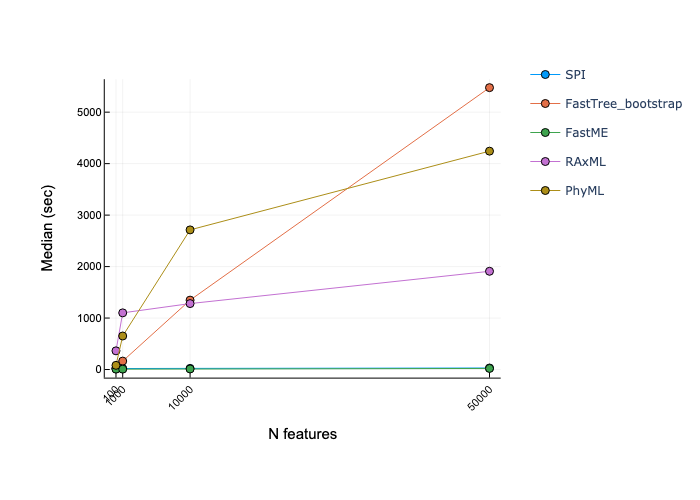

In [63]:
@df mediantimedf plot(:nfeatures, 
    [:SPI :FastTree_bootstrap :FastME :RAxML :PhyML],
    xlabel="N features",
    ylabel="Median (sec)",
    margin=5Plots.Measures.mm,
    marker=true,
    xrotation=45,
    xticks=([100, 1000, 10000, 50000], string.([100, 1000, 10000, 50000])),
    legend=:right)

# Extra

In [ ]:
plot(ylabel="fscore", xlabel="homoplasy", 
xlims=(-0.1,1.1),
ylims=(-0.1,1.1),
)

@df plotdf scatter!(:homoplasy, :FastME_fscore, c=3, label="FastME")
k = KernelDensity.kde((plotdf.homoplasy, plotdf.FastME_fscore))
contour!(k, levels=[quantile(k.density[:], .5)], c=3, colorbar=:none, lw=3)

@df plotdf scatter!(:homoplasy, :FastTree_fscore, c=2, label="FastTree")
k = KernelDensity.kde((plotdf.homoplasy, plotdf.FastTree_fscore))
contour!(k, levels=[quantile(k.density[:], .5)], c=2, colorbar=:none, lw=3)

@df plotdf scatter!(:homoplasy, :SPI_fscore, c=1, label="SPI")
k = KernelDensity.kde((plotdf.homoplasy, plotdf.SPI_fscore))
contour!(k, levels=[quantile(k.density[:], .5)], c=1, colorbar=:none, lw=3)


In [ ]:
plot(ylabel="fscore", xlabel="homoplasy", 
xlims=(-0.1,1.1),
ylims=(-0.1,1.1),
)

@df plotdf90 scatter!(:homoplasy, :FastME_fscore, c=3, label="FastME")
k = KernelDensity.kde((plotdf90.homoplasy, plotdf90.FastME_fscore))
contour!(k, levels=[quantile(k.density[:], .5)], c=3, colorbar=:none, lw=3)

@df plotdf90 scatter!(:homoplasy, :FastTree_fscore, c=2, label="FastTree")
k = KernelDensity.kde((plotdf90.homoplasy, plotdf90.FastTree_fscore))
contour!(k, levels=[quantile(k.density[:], .5)], c=2, colorbar=:none, lw=3)

@df plotdf90 scatter!(:homoplasy, :SPI_fscore, c=1, label="SPI")
k = KernelDensity.kde((plotdf90.homoplasy, plotdf90.SPI_fscore))
contour!(k, levels=[quantile(k.density[:], .5)], c=1, colorbar=:none, lw=3)


In [ ]:
plot(ylabel="recall", xlabel="homoplasy", 
xlims=(-0.1,1.1),
ylims=(-0.1,1.1),
)

@df plotdf scatter!(:homoplasy, :FastME_recall, c=3, label="FastME")
k = KernelDensity.kde((plotdf.homoplasy, plotdf.FastME_recall))
contour!(k, levels=[quantile(k.density[:], .5)], c=3, colorbar=:none, lw=3)

@df plotdf scatter!(:homoplasy, :FastTree_recall, c=2, label="FastTree")
k = KernelDensity.kde((plotdf.homoplasy, plotdf.FastTree_recall))
contour!(k, levels=[quantile(k.density[:], .5)], c=2, colorbar=:none, lw=3)

@df plotdf scatter!(:homoplasy, :SPI_recall, c=1, label="SPI")
k = KernelDensity.kde((plotdf.homoplasy, plotdf.SPI_recall))
contour!(k, levels=[quantile(k.density[:], .5)], c=1, colorbar=:none, lw=3)


In [ ]:
plot(ylabel="recall", xlabel="homoplasy", 
xlims=(-0.1,1.1),
ylims=(-0.1,1.1),
)

@df plotdf90 scatter!(:homoplasy, :FastME_recall, c=3, label="FastME")
k = KernelDensity.kde((plotdf90.homoplasy, plotdf90.FastME_recall))
contour!(k, levels=[quantile(k.density[:], .5)], c=3, colorbar=:none, lw=3)

@df plotdf90 scatter!(:homoplasy, :FastTree_recall, c=2, label="FastTree")
k = KernelDensity.kde((plotdf90.homoplasy, plotdf90.FastTree_recall))
contour!(k, levels=[quantile(k.density[:], .5)], c=2, colorbar=:none, lw=3)

@df plotdf90 scatter!(:homoplasy, :SPI_recall, c=1, label="SPI")
k = KernelDensity.kde((plotdf90.homoplasy, plotdf90.SPI_recall))
contour!(k, levels=[quantile(k.density[:], .5)], c=1, colorbar=:none, lw=3)


In [ ]:
plot(ylabel="elapsed time (sec)", xlabel="N features")
@df plotdf scatter!(:nfeatures, :SPI_elapsedsecs, label="SPI")
@df plotdf scatter!(:nfeatures, :FastTree_elapsedsecs,  label="FastTree")
@df plotdf scatter!(:nfeatures, :FastME_elapsedsecs, label="FastME")

In [ ]:
tmpdf = stack(plotdf90, [:SPI_elapsedsecs, :FastTree_elapsedsecs, :FastME_elapsedsecs, :RAxML_elapsedsecs]);
tmpdf = tmpdf[.!ismissing.(tmpdf.value),:];

In [ ]:
plot(layout=grid(3,4), size=(900, 800), xlabel="method", ylabel="elapsed time (sec)", margin=2Plots.Measures.mm)
plotnum = 1
for nb in sort(unique(tmpdf.nbits))
    for nf in sort(unique(tmpdf.nfeatures))
        xtickslabels = sort(first.(split.(unique(tmpdf.variable), "_")))
        @df tmpdf[(tmpdf.nfeatures .== nf) .& (tmpdf.nbits .== nb), :] dotplot!(:variable, :value, 
            title="Naa=$nf, Nbits=$nb",
            titlefontsize=8,
            sp=plotnum, 
            xrotation=45, 
            markerstrokewidth=.1,
            xticks=((1:4).-.5, xtickslabels),
            label="",
            )
        plotnum += 1
    end
end
plot!()

In [ ]:
xtickslabels = sort(first.(split.(unique(tmpdf.variable), "_")))
@df tmpdf dotplot(:variable, :value, 
            # title="nfeatures=$nf, nbits=$nb",
            xlabel="method", ylabel="elapsed time (sec)",
            titlefontsize=8,
            # sp=plotnum, 
            # xrotation=45, 
            markerstrokewidth=.1,
            xticks=((1:3).-.5, xtickslabels),
            label="",
            )

In [ ]:
mediantimedf = plotdf90 |>
    df->groupby(df,:nfeatures) |>
    df->combine(df,
        :SPI_elapsedsecs => median => :SPI,
        :FastTree_elapsedsecs => median => :FastTree,
        :FastME_elapsedsecs => median => :FastME,
        :RAxML_elapsedsecs => median => :RAxML,
        )

In [ ]:
@df mediantimedf plot(:nfeatures, 
    [:SPI :FastTree :FastME :RAxML],
    xlabel="N features",
    ylabel="Median (sec)",
    margin=5Plots.Measures.mm,
    marker=true,
    xrotation=45,
    xticks=([100, 1000, 10000, 50000], string.([100, 1000, 10000, 50000])),
    legend=:right)

In [ ]:
tmpdf = stack(plotdf90, reverse([:SPI_recall, :FastTree_recall, :FastME_recall]));
plot(layout=grid(3,4), size=(1000, 900), ylim=(-0.01,1.01), xlabel="method", ylabel="recall", margin=2Plots.Measures.mm)
plotnum = 1
for nb in sort(unique(tmpdf.nbits))
    for nf in sort(unique(tmpdf.nfeatures))
        xtickslabels = reverse(first.(split.(unique(tmpdf.variable), "_")))
        @df tmpdf[(tmpdf.nfeatures .== nf) .& (tmpdf.nbits .== nb), :] dotplot!(:variable, :value,
            group=:variable,
            title="nfeatures=$nf, nbits=$nb",
            titlefontsize=8,
            sp=plotnum, 
            xrotation=30, 
            markerstrokewidth=.1,
            c=[3 2 1],
            # xticks=(1:3, xtickslabels),
            label="",
            )
        plotnum += 1
    end
end
plot!()

In [ ]:
tmpdf = stack(plotdf90, reverse([:SPI_fscore, :FastTree_fscore, :FastME_fscore]));
plot(layout=grid(3,4), size=(1000, 900), ylim=(-0.01,1.01), xlabel="method", ylabel="fscore", margin=2Plots.Measures.mm)
plotnum = 1
for nb in sort(unique(tmpdf.nbits))
    for nf in sort(unique(tmpdf.nfeatures))
        xtickslabels = reverse(first.(split.(unique(tmpdf.variable), "_")))
        @df tmpdf[(tmpdf.nfeatures .== nf) .& (tmpdf.nbits .== nb), :] dotplot!(:variable, :value,
            group=:variable,
            title="nfeatures=$nf, nbits=$nb",
            titlefontsize=8,
            sp=plotnum, 
            xrotation=30, 
            markerstrokewidth=.1,
            c=[3 2 1],
            # xticks=(1:3, xtickslabels),
            label="",
            )
        plotnum += 1
    end
end
plot!()

In [ ]:
tmpdf = stack(plotdf90, reverse([:SPI_fscore, :FastTree_fscore, :FastME_fscore]));
plot(layout=grid(4,6), size=(1200, 900), ylim=(-0.01,1.01), xlabel="method", ylabel="fscore", margin=5Plots.Measures.mm)
plotnum = 1
for n1 in sort(unique(tmpdf.ntaxa))
    for n2 in sort(unique(tmpdf.treetype))
        xtickslabels = reverse(first.(split.(unique(tmpdf.variable), "_")))
        @df tmpdf[(tmpdf.ntaxa .== n1) .& (tmpdf.treetype .== n2), :] dotplot!(:variable, :value,
            group=:variable,
            title="ntaxa=$n1, type=$(replace(n2,r"tree"=>""))",
            titlefontsize=8,
            sp=plotnum, 
            xrotation=30, 
            markerstrokewidth=.1,
            c=[3 2 1],
            # xticks=(1:3, xtickslabels),
            label="",
            )
        plotnum += 1
    end
end
plot!()

In [ ]:
tmpdf = stack(plotdf90, reverse([:SPI_recall, :FastTree_recall, :FastME_recall]));
plot(layout=grid(4,6), size=(1200, 900), ylim=(-0.01,1.01), xlabel="method", ylabel="recall", margin=5Plots.Measures.mm)
plotnum = 1
for n1 in sort(unique(tmpdf.ntaxa))
    for n2 in sort(unique(tmpdf.treetype))
        xtickslabels = reverse(first.(split.(unique(tmpdf.variable), "_")))
        @df tmpdf[(tmpdf.ntaxa .== n1) .& (tmpdf.treetype .== n2), :] dotplot!(:variable, :value,
            group=:variable,
            title="ntaxa=$n1, type=$(replace(n2,r"tree"=>""))",
            titlefontsize=8,
            sp=plotnum, 
            xrotation=30, 
            markerstrokewidth=.1,
            c=[3 2 1],
            # xticks=(1:3, xtickslabels),
            label="",
            )
        plotnum += 1
    end
end
plot!()

In [ ]:
tmpdf = stack(plotdf90, reverse([:SPI_precision, :FastTree_precision, :FastME_precision]));
plot(layout=grid(4,6), size=(1200, 900), ylim=(-0.01,1.01), xlabel="method", ylabel="precision", margin=5Plots.Measures.mm)
plotnum = 1
for n1 in sort(unique(tmpdf.ntaxa))
    for n2 in sort(unique(tmpdf.treetype))
        xtickslabels = reverse(first.(split.(unique(tmpdf.variable), "_")))
        @df tmpdf[(tmpdf.ntaxa .== n1) .& (tmpdf.treetype .== n2), :] dotplot!(:variable, :value,
            group=:variable,
            title="ntaxa=$n1, type=$(replace(n2,r"tree"=>""))",
            titlefontsize=8,
            sp=plotnum, 
            xrotation=30, 
            markerstrokewidth=.1,
            c=[3 2 1],
            # xticks=(1:3, xtickslabels),
            label="",
            )
        plotnum += 1
    end
end
plot!()